In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import datasets,transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torchsummary import summary
torch.manual_seed(0) # Set for testing purposes, please do not change!

In [2]:
DATA_DIR = "D:/Kaggle/deep-learning/generative-dog-images/data/all-dogs-parent/"
RESULTS_DIR = "D:/Kaggle/deep-learning/generative-dog-images/wgan-v1-outputs/"
CHK_PTS_DIR = "D:/Kaggle/deep-learning/generative-dog-images/checkpoints/"

In [3]:
batch_size = 64
image_size = 64

#apply augmentations on the images and Resize and center crop them
#Normalize images to -1, 1 range
random_transforms = [transforms.ColorJitter(), transforms.RandomRotation(degrees=20)]
transform = transforms.Compose([transforms.Resize(64),
                                transforms.CenterCrop(64),
                                transforms.RandomHorizontalFlip(p=0.5),
                                transforms.RandomApply(random_transforms, p=0.2),
                                transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

train_data = datasets.ImageFolder(DATA_DIR, transform=transform)
dataloader = torch.utils.data.DataLoader(train_data, shuffle=True,
                                           batch_size=batch_size)
                                           
imgs, label = next(iter(dataloader))
imgs = imgs.numpy().transpose(0, 2, 3, 1)

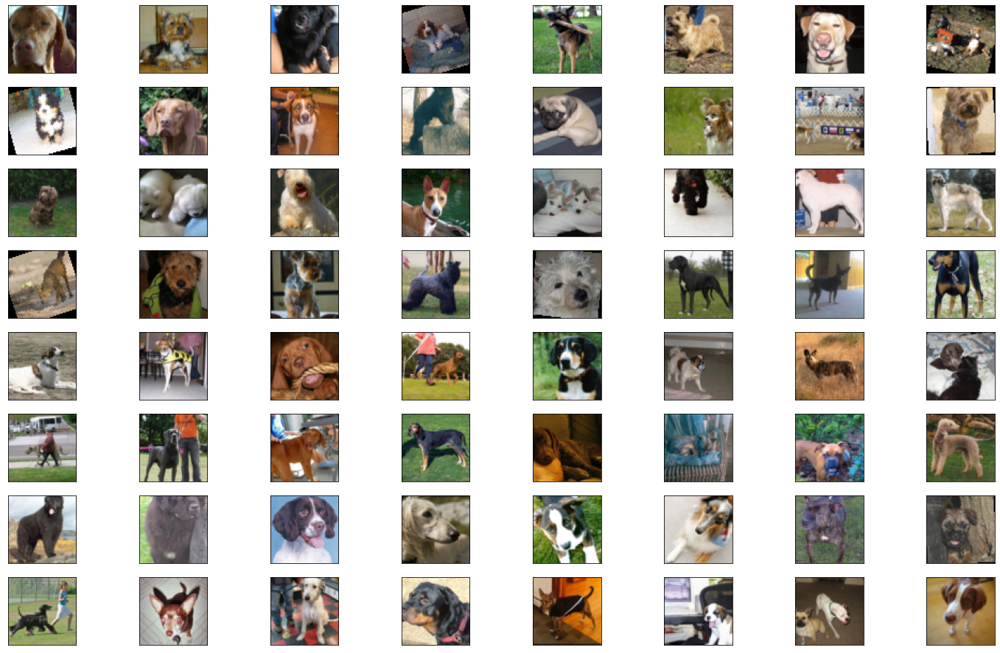

In [4]:
fig = plt.figure(figsize=(25, 16))
for ii, img in enumerate(imgs):
    ax = fig.add_subplot(8, 8, ii + 1, xticks=[], yticks=[])
    
    plt.imshow((img+1.)/2.)

In [5]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()
    
def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

In [6]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        '''
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )
        '''
        self.gen = nn.Sequential(
                nn.ConvTranspose2d(100, 512, 4, stride=1, padding=0),
                nn.BatchNorm2d(512),
                nn.ReLU(inplace=True),
                nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1),
                nn.BatchNorm2d(256),
                nn.ReLU(inplace=True),
                nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),
                nn.BatchNorm2d(128),
                nn.ReLU(inplace=True),
                nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
                nn.BatchNorm2d(64),
                nn.ReLU(inplace=True),
                nn.ConvTranspose2d(64, im_chan, 4, stride=2, padding=1),
                nn.Tanh()
                )
    '''
    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )
    '''
    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)
    
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

In [7]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=3, hidden_dim=64):
        super(Critic, self).__init__()
        '''
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )
        '''
        self.crit = nn.Sequential(
                nn.Conv2d(im_chan, 64, 4, stride=2, padding=1),
                nn.BatchNorm2d(64),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(64, 128, 4, stride=2, padding=1),
                nn.BatchNorm2d(128),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(128, 256, 4, stride=2, padding=1),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(256, 512, 4, stride=2, padding=1),
                nn.BatchNorm2d(512),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(512, 1, 3, stride=2, padding=0),
                )
        
    '''
    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )
    '''
    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

In [8]:
n_epochs = 100
z_dim = 100
display_step = 50
batch_size = 64
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 3
device = 'cuda'

In [9]:
gen = Generator(z_dim).to(device)
#print(gen)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
#print(crit)

crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

In [10]:
summary(gen, (100,))
summary(crit, (3,64,64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,712
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,408
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,416
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,136
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,075
             Tanh-14            [-1, 3,

In [11]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    #print(real.shape)
    #print(fake.shape)
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    #print("ms",mixed_scores.shape)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient

In [12]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    #print(gradient.shape)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 3, 64, 64))
print("Success!")

Success!


In [13]:
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [14]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 3, 64, 64))
print("Success!")

Success!


In [15]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -1. * torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [16]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


In [17]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [18]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


In [29]:
CHK_PT = "D:/Kaggle/deep-learning/generative-dog-images/checkpoints/wgan-v1-1.pt"
#CHK_PT = "D:/Kaggle/deep-learning/generative-dog-images/wgan-v1-0.pt"
checkpoint = torch.load(CHK_PT)
gen.load_state_dict(checkpoint['gen_state_dict'])
crit.load_state_dict(checkpoint['crit_state_dict'])
gen_opt.load_state_dict(checkpoint['gen_optimizer_state_dict'])
crit_opt.load_state_dict(checkpoint['crit_optimizer_state_dict'])
epoch = checkpoint['epoch']
errG = checkpoint['gen_loss']
errD = checkpoint['crit_loss']


Step 50: Generator loss: -6.072695274353027, critic loss: -1.7394908062616992


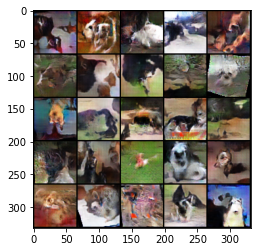

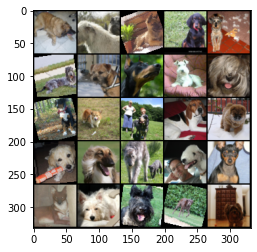

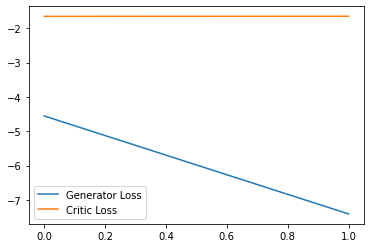

Step 100: Generator loss: -7.178280887603759, critic loss: -1.9464525512854254


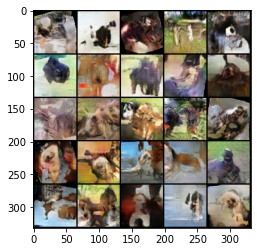

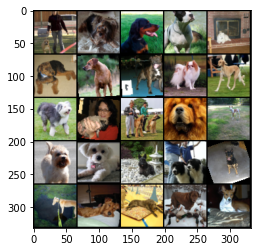

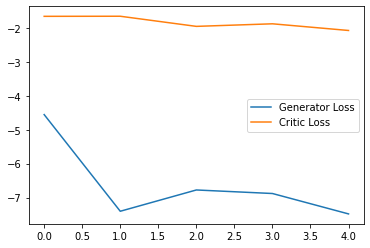

Step 150: Generator loss: -7.778338955640793, critic loss: -2.0750085953871418


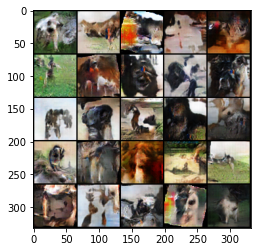

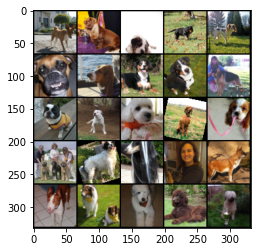

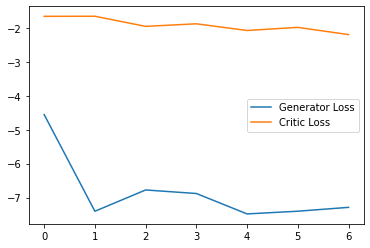

Step 200: Generator loss: -6.887574379444122, critic loss: -2.2893769098321597


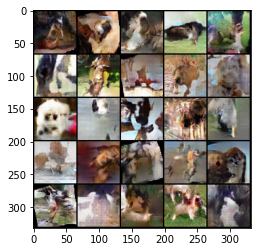

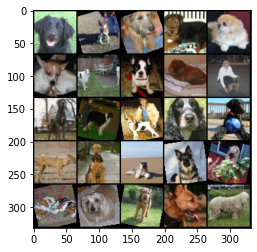

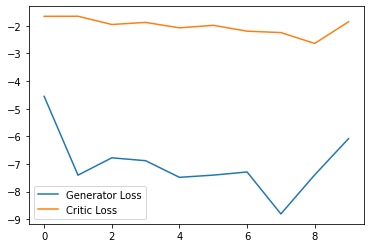

Step 250: Generator loss: -6.383564357757568, critic loss: -1.808590523203214


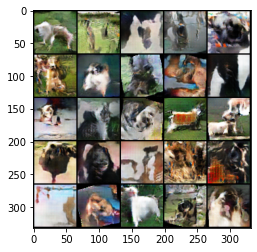

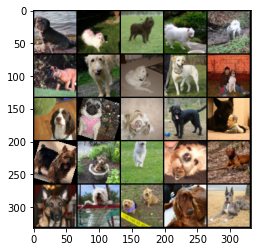

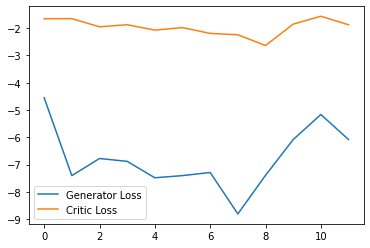

Step 300: Generator loss: -6.585942136049271, critic loss: -2.451317945321401


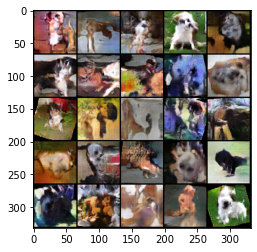

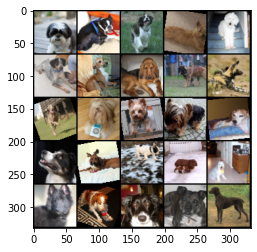

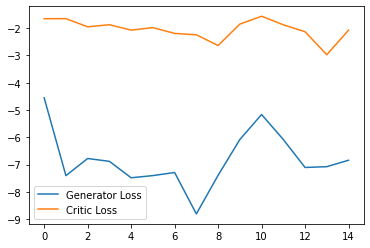

Step 350: Generator loss: -1.615756460428238, critic loss: -1.1236076183865469


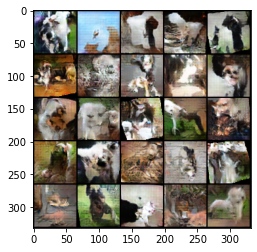

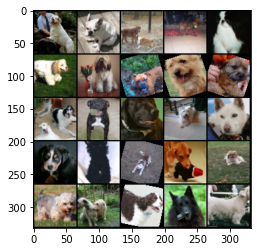

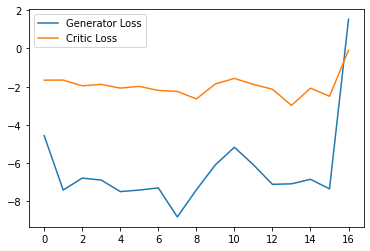

Step 400: Generator loss: 0.36129886358976365, critic loss: -1.008751137405634


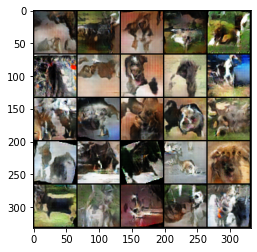

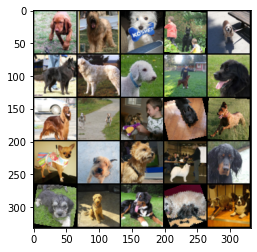

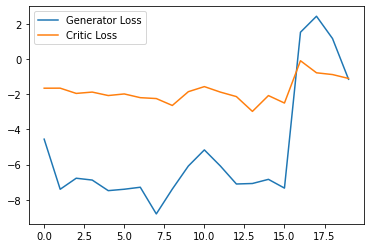

Step 450: Generator loss: -0.5797377356886864, critic loss: -1.2279011718432107


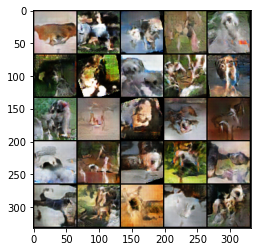

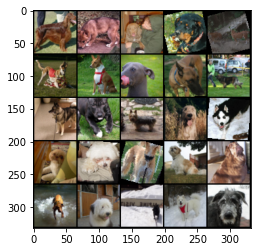

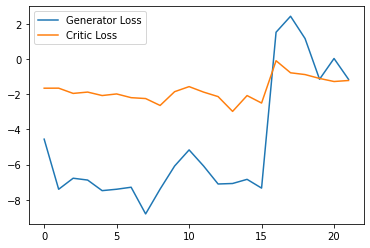

Step 500: Generator loss: -1.5049402752518655, critic loss: -1.3901664634545645


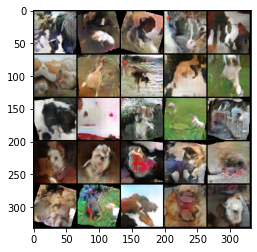

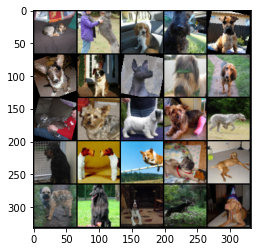

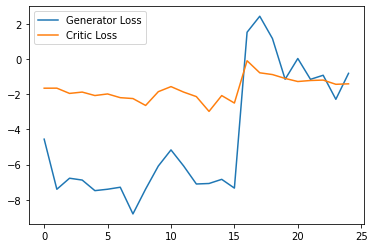

Step 550: Generator loss: -2.3970894011855126, critic loss: -1.6303997155030567


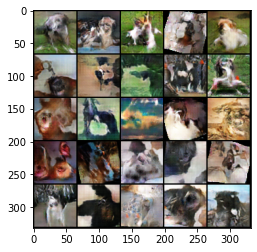

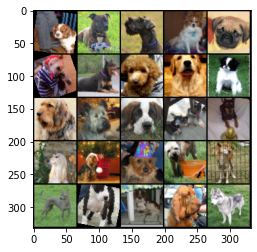

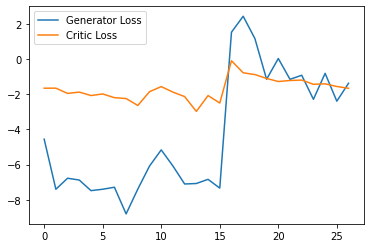

Step 600: Generator loss: -3.5077593997120857, critic loss: -1.7045218761761987


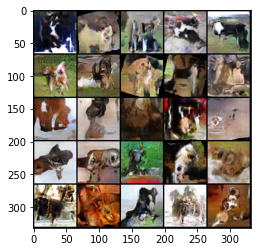

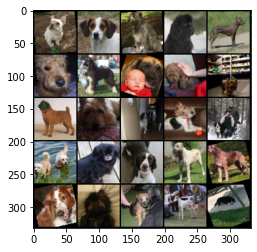

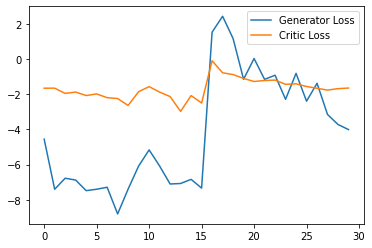

Step 650: Generator loss: -3.680958728790283, critic loss: -1.9312404529253648


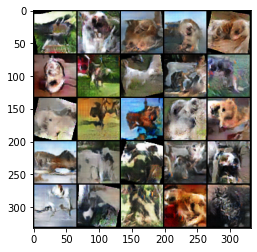

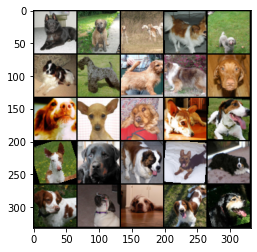

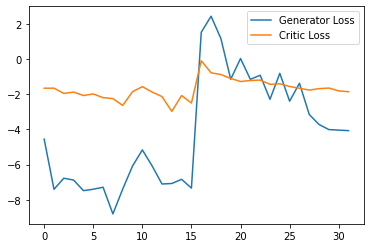

Step 700: Generator loss: -5.15055227637291, critic loss: -2.0480313787857685


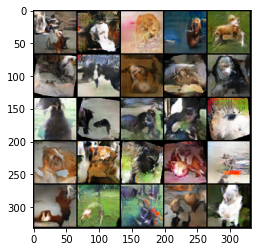

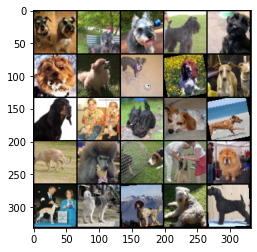

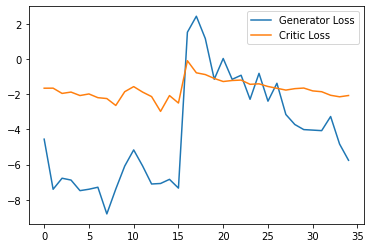

Step 750: Generator loss: -5.816389653682709, critic loss: -2.4169345027208324


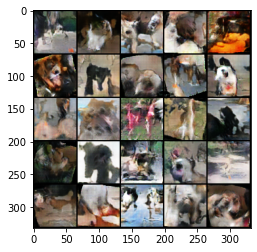

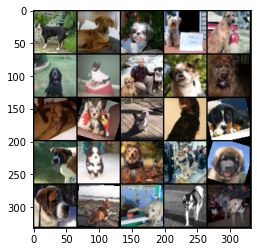

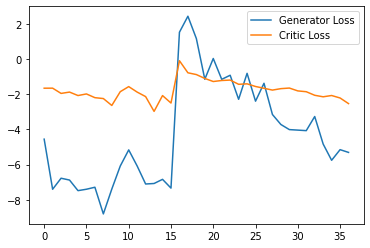

Step 800: Generator loss: -1.5834558880329133, critic loss: -0.80719985862573


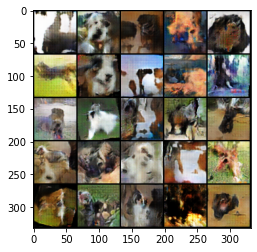

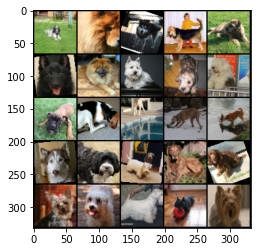

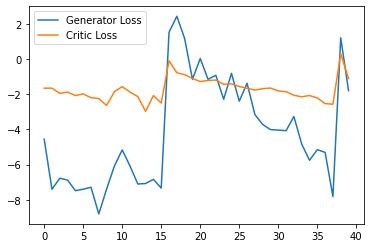

Step 850: Generator loss: -3.3055793035030363, critic loss: -1.3833728023370109


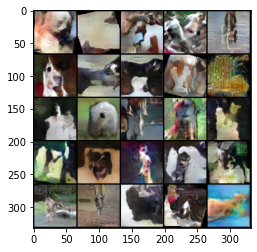

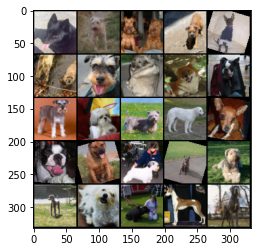

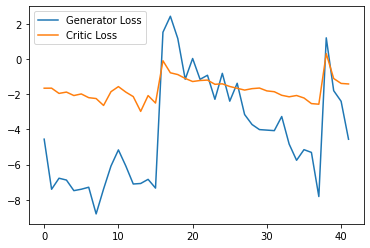

Step 900: Generator loss: -4.216889069080353, critic loss: -1.6482772390047713


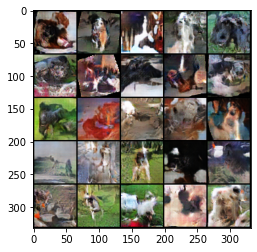

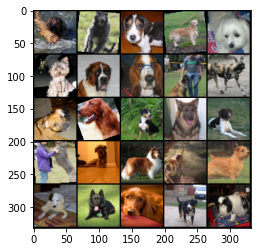

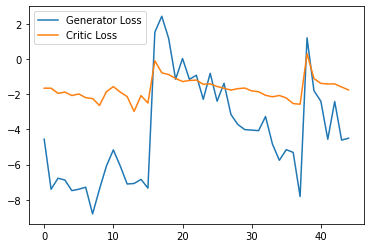

Step 950: Generator loss: -5.534873948097229, critic loss: -1.9910270877679193


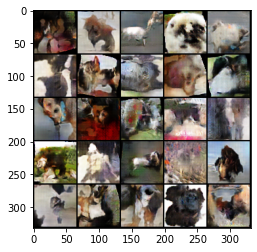

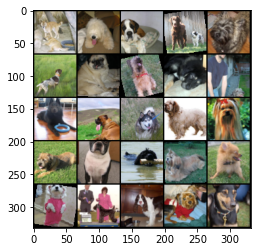

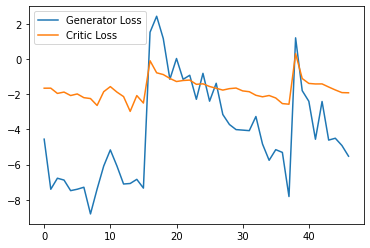

Step 1000: Generator loss: -8.029926581382751, critic loss: -1.908413939277331


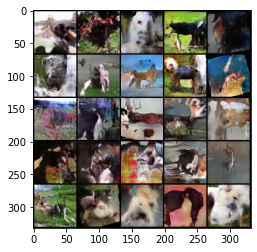

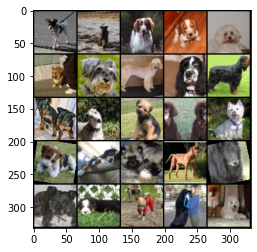

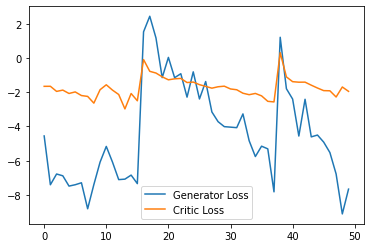

Step 1050: Generator loss: -6.996487679481507, critic loss: -2.300441957712173


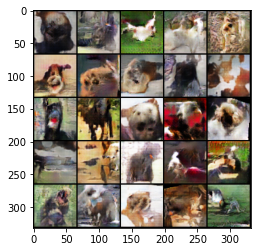

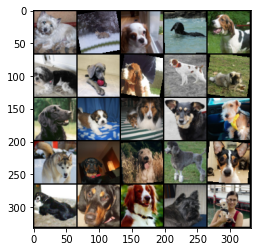

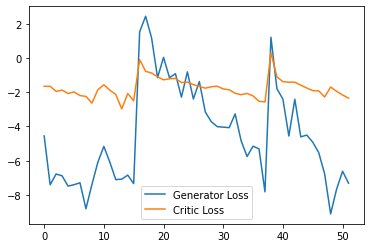

Step 1100: Generator loss: -4.6689862829446795, critic loss: -1.7098650442063805


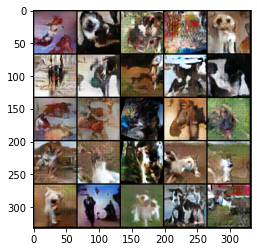

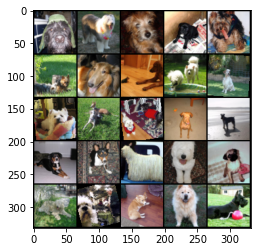

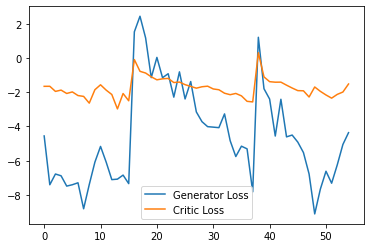

Step 1150: Generator loss: 1.296284337937832, critic loss: -0.8944683960080145


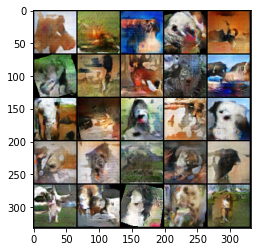

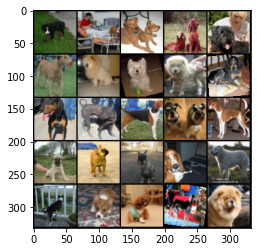

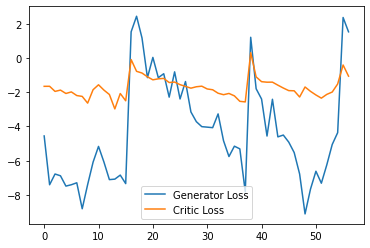

Step 1200: Generator loss: 0.9785239344835281, critic loss: -1.284238496720791


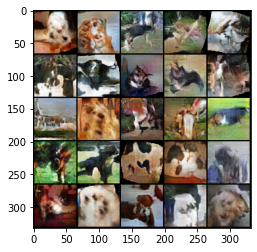

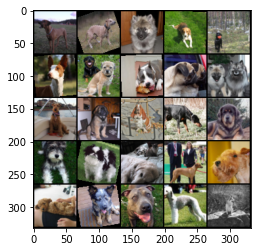

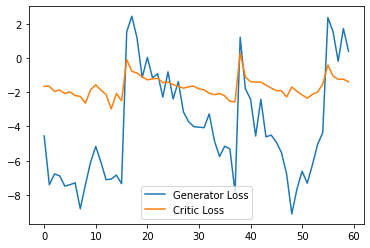

Step 1250: Generator loss: -0.6933727464079857, critic loss: -1.5765993084510164


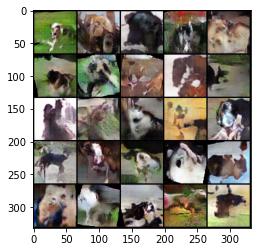

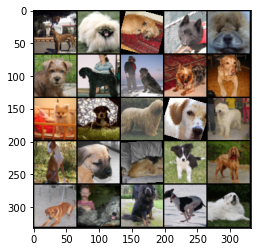

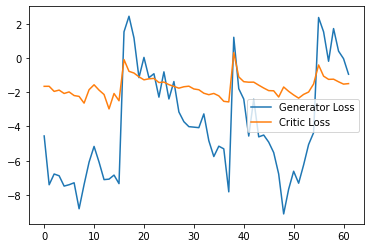

Step 1300: Generator loss: -2.665121043920517, critic loss: -1.894221751292547


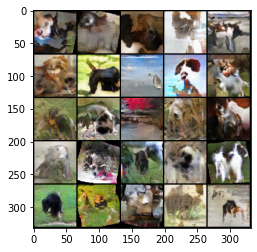

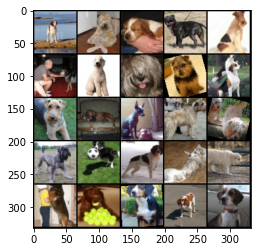

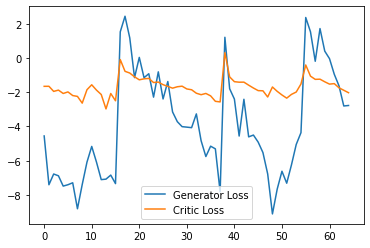

Step 1350: Generator loss: -5.7189519548416134, critic loss: -2.282589871088664


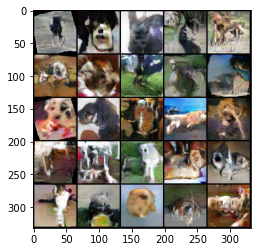

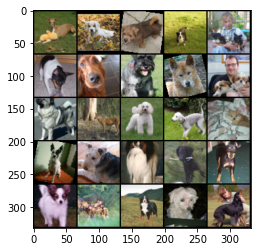

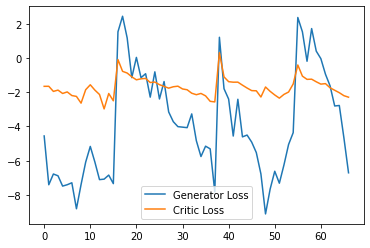

Step 1400: Generator loss: -6.139329718351364, critic loss: -2.0447901101907098


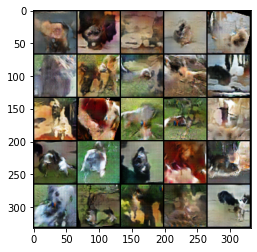

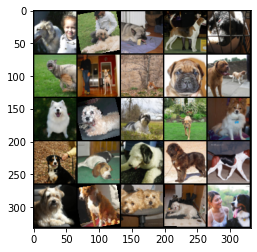

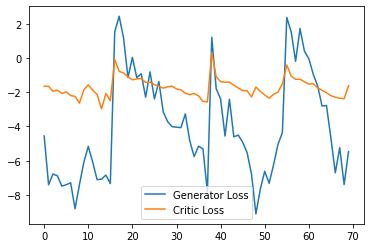

Step 1450: Generator loss: -4.651911069154739, critic loss: -2.089989929397901


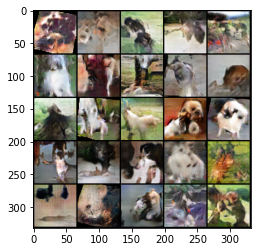

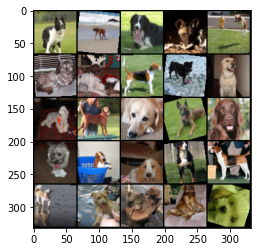

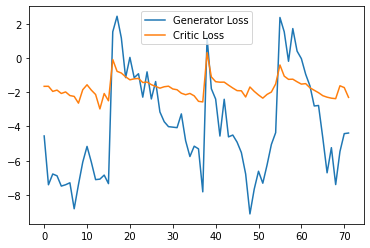

Step 1500: Generator loss: -12.819353289604187, critic loss: -1.2706970429917175


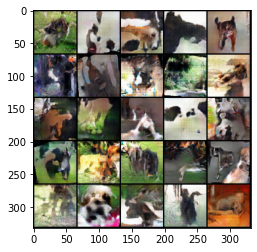

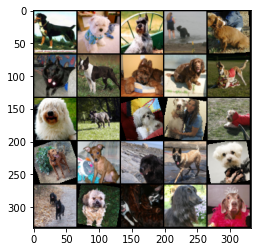

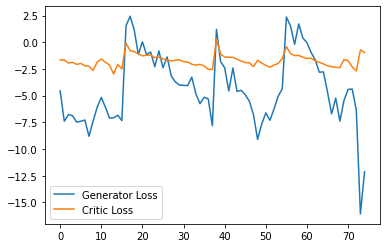

Step 1550: Generator loss: -8.971088542938233, critic loss: -1.5242434526483222


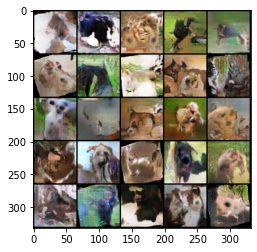

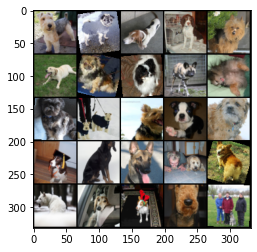

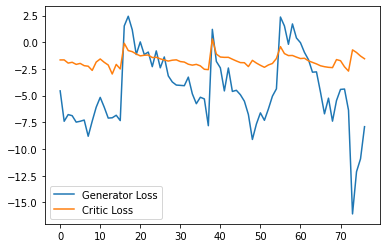

Step 1600: Generator loss: -7.1489875650405885, critic loss: -2.13800202190876


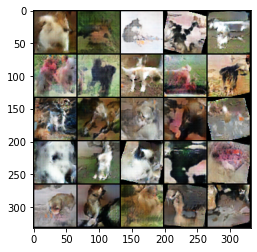

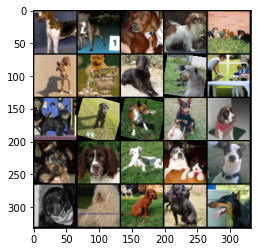

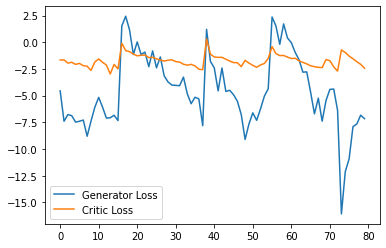

Step 1650: Generator loss: -6.443387973308563, critic loss: -2.117037517825763


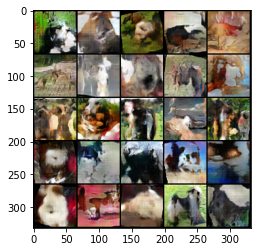

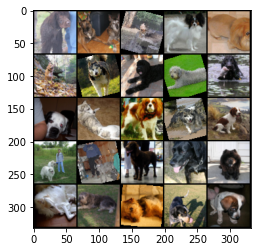

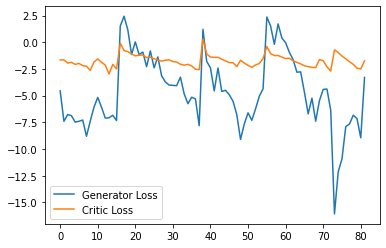

Step 1700: Generator loss: -5.971666396856308, critic loss: -2.1227063736319547


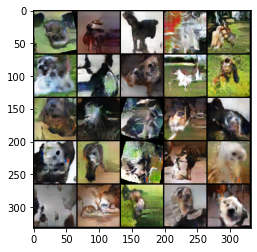

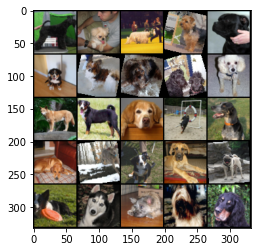

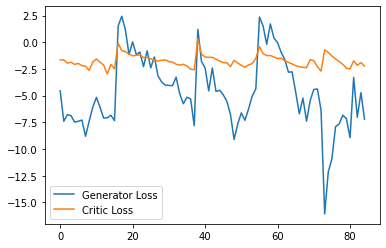

Step 1750: Generator loss: -4.82166057407856, critic loss: -1.4548021673162788


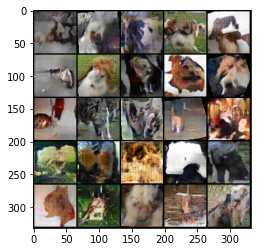

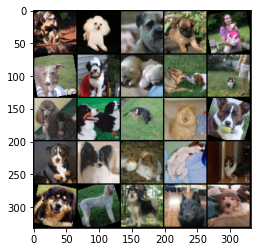

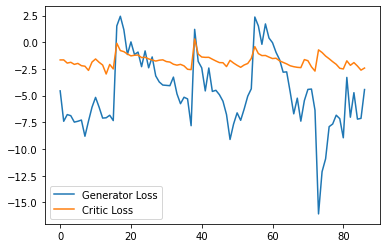

Step 1800: Generator loss: 1.9886390125751496, critic loss: -0.42796544810136156


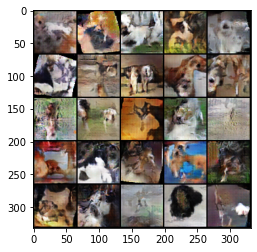

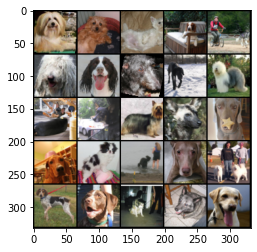

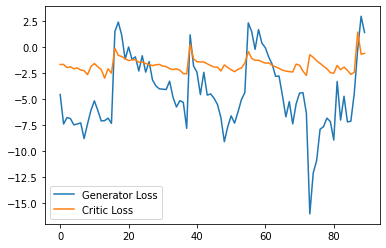

Step 1850: Generator loss: 1.1895932072401048, critic loss: -0.7350063410152989


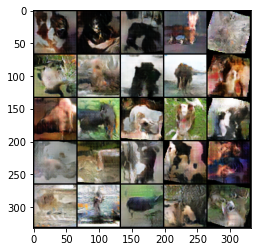

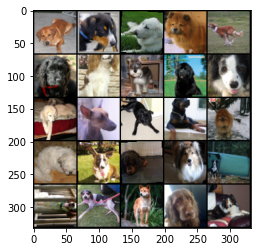

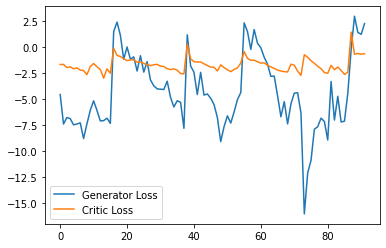

Step 1900: Generator loss: 0.555062620639801, critic loss: -0.9127612147728602


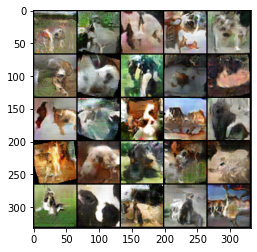

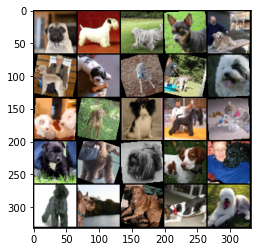

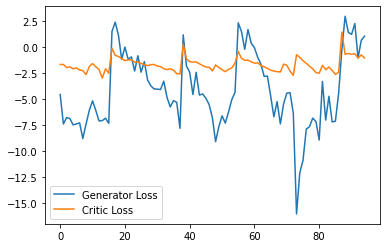

Step 1950: Generator loss: 1.7281545168161392, critic loss: -1.115964846437176


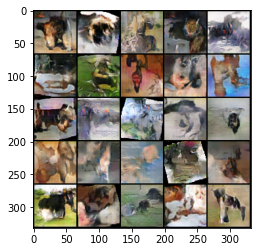

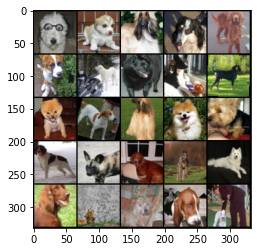

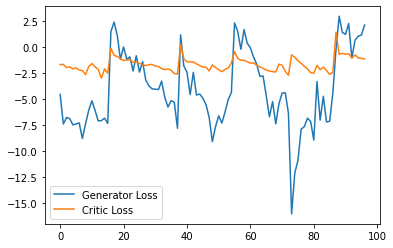

Step 2000: Generator loss: 0.19000223219394685, critic loss: -1.2532357364147904


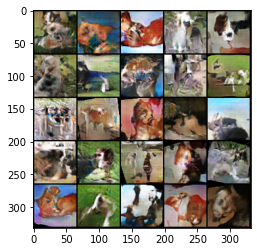

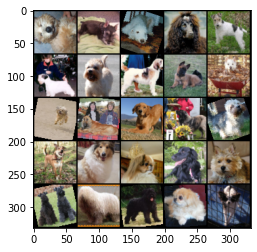

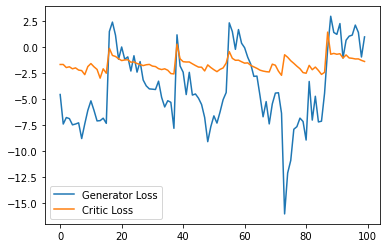

Step 2050: Generator loss: -1.8691603994369508, critic loss: -1.4227056875824928


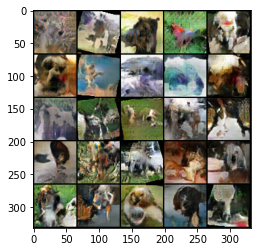

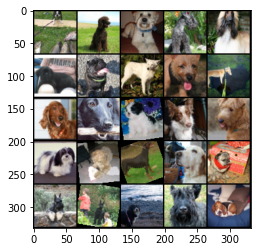

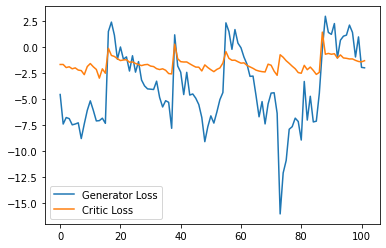

Step 2100: Generator loss: -0.8794908809661866, critic loss: -1.4886449559529624


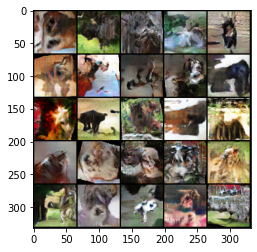

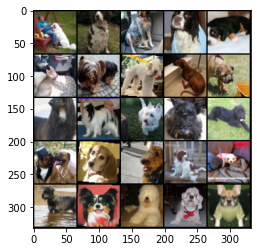

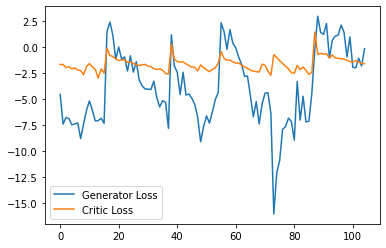

Step 2150: Generator loss: -1.9368964368104935, critic loss: -1.6416472290953001


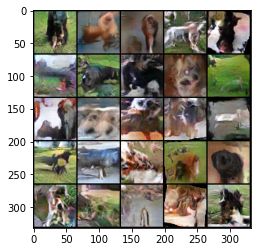

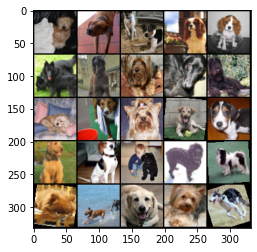

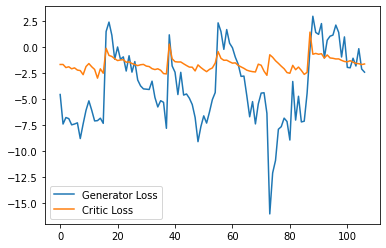

Step 2200: Generator loss: -2.278362385928631, critic loss: -1.7549872543414435


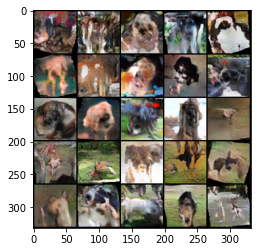

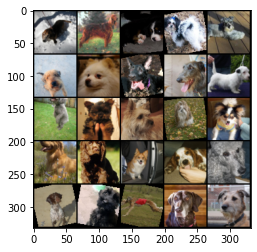

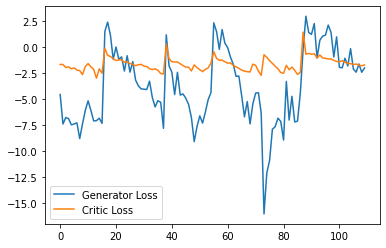

Step 2250: Generator loss: -3.3341006696224214, critic loss: -1.8004176326592762


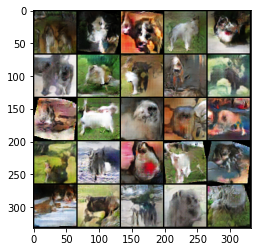

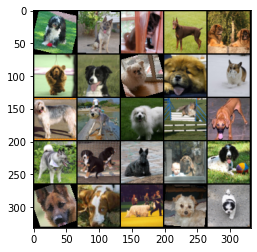

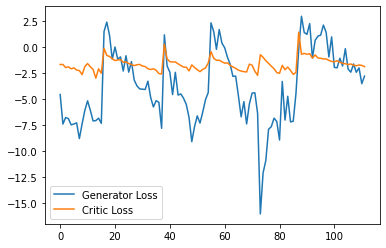

Step 2300: Generator loss: -3.650847897529602, critic loss: -1.914931857585907


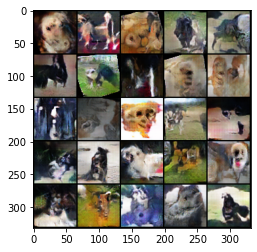

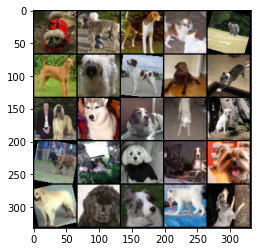

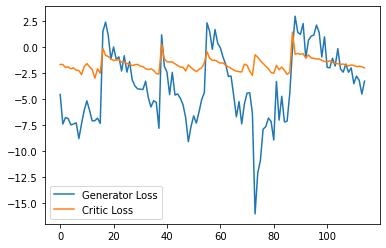

Step 2350: Generator loss: -4.7412572503089905, critic loss: -2.074584229787191


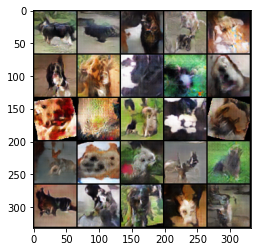

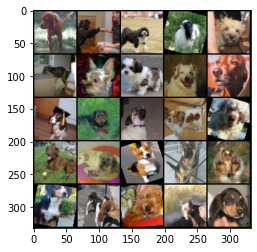

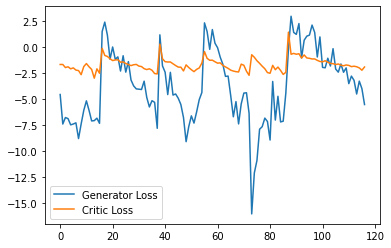

Step 2400: Generator loss: -4.964112985730171, critic loss: -2.205129768649737


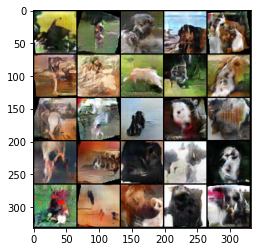

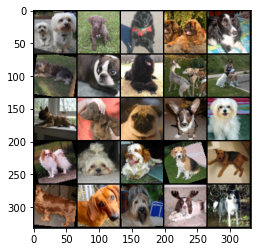

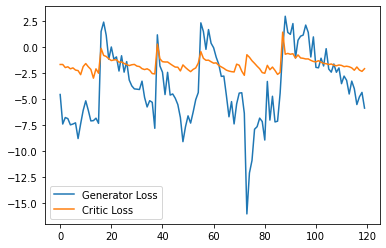

Step 2450: Generator loss: -5.5593470177054405, critic loss: -2.170585655073325


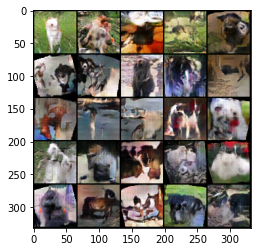

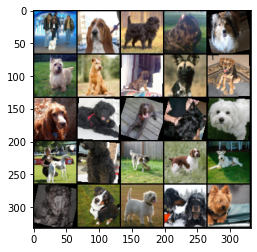

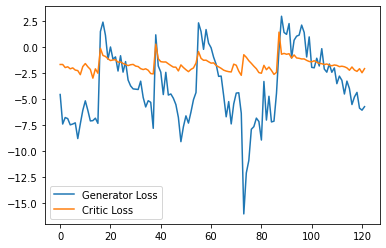

Step 2500: Generator loss: -8.344444189071655, critic loss: -1.6484263682365417


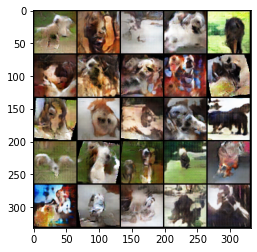

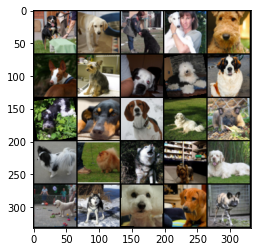

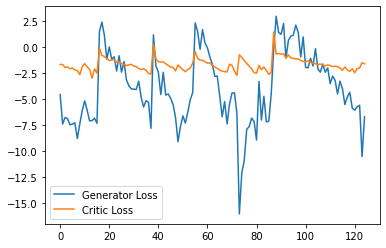

Step 2550: Generator loss: -6.188277470469475, critic loss: -2.090550730625788


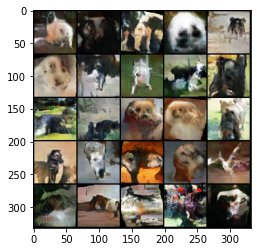

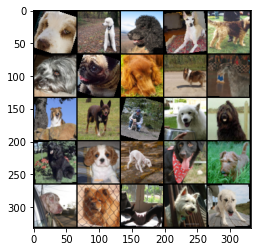

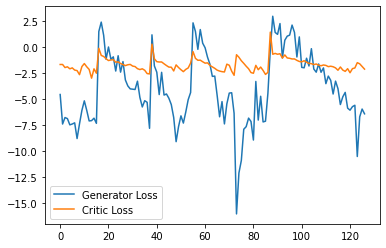

Step 2600: Generator loss: -7.367971243858338, critic loss: -2.7283429735898967


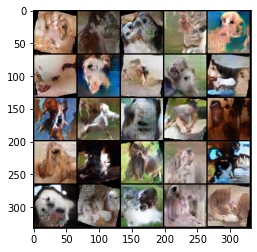

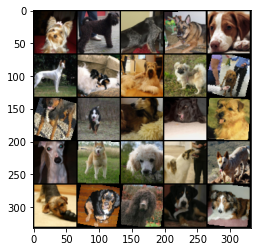

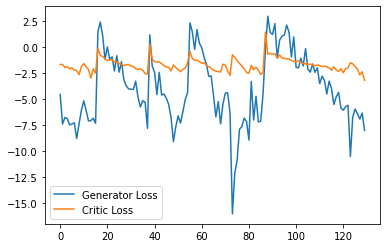

Step 2650: Generator loss: -7.559473555088044, critic loss: -1.5468607197205224


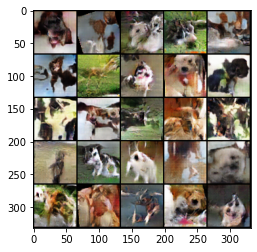

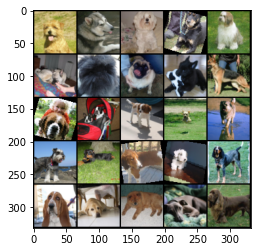

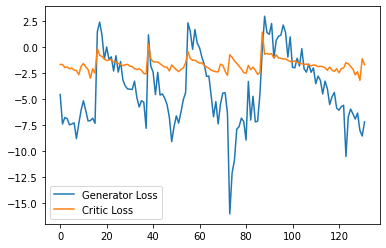

Step 2700: Generator loss: -5.419933377504349, critic loss: -2.408797560830911


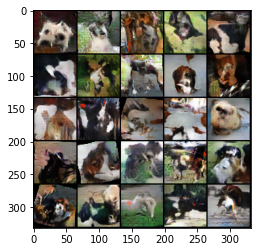

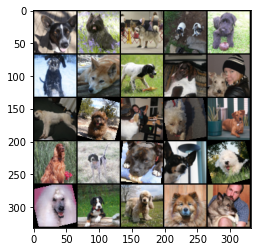

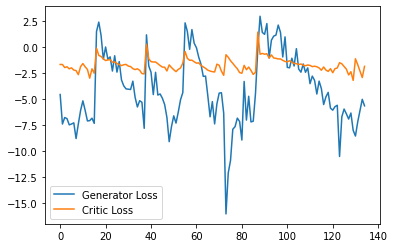

Step 2750: Generator loss: -5.644032294154167, critic loss: -1.6305265009899934


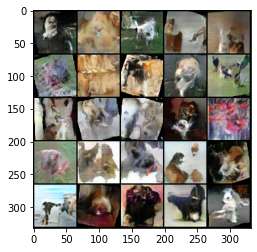

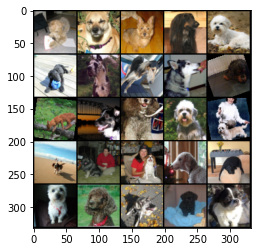

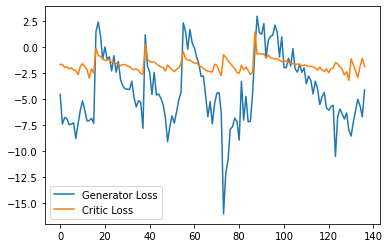

Step 2800: Generator loss: -4.81705885887146, critic loss: -1.9935187520583475


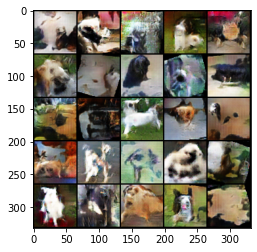

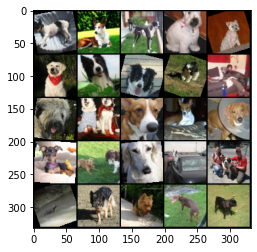

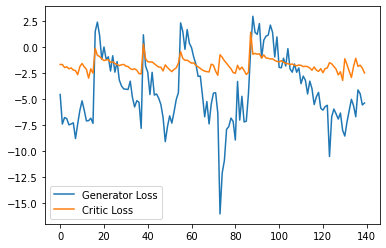

Step 2850: Generator loss: -8.20620651125908, critic loss: -1.7215451916058861


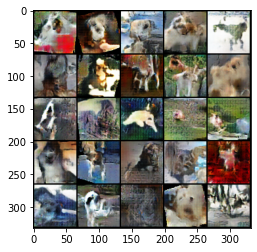

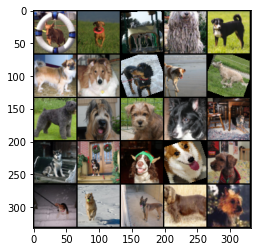

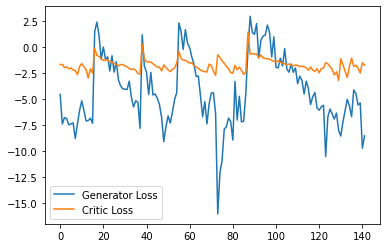

Step 2900: Generator loss: -8.425975099802017, critic loss: -2.431131433298191


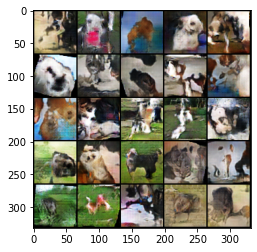

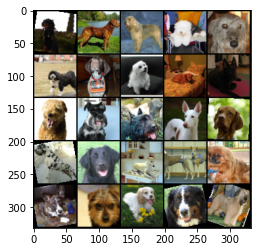

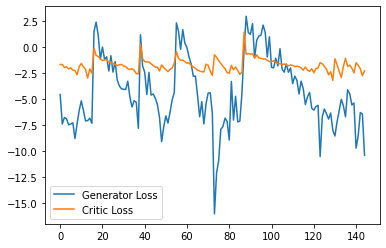

Step 2950: Generator loss: -7.433709428310395, critic loss: -2.2267790200312936


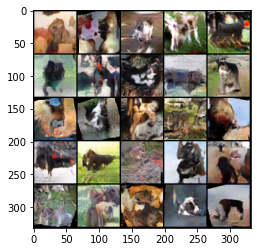

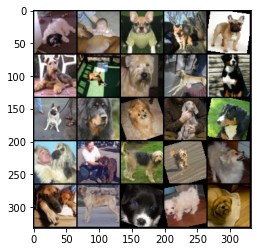

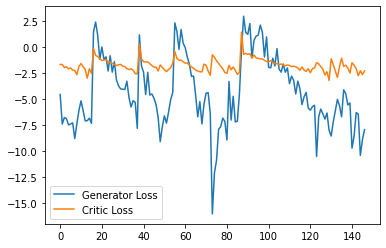

Step 3000: Generator loss: -5.514347271919251, critic loss: -2.111333917776743


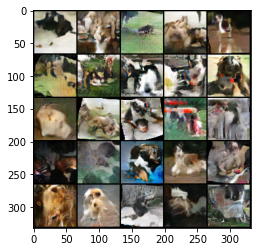

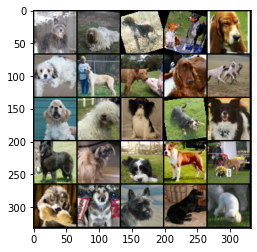

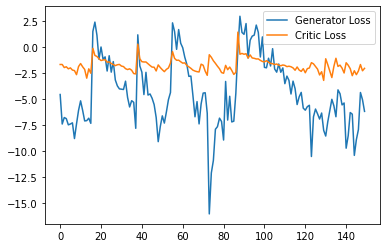

Step 3050: Generator loss: -5.439713832139969, critic loss: -1.8799270243446022


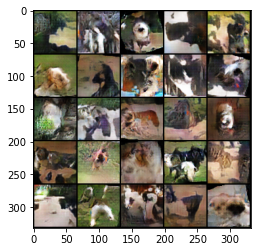

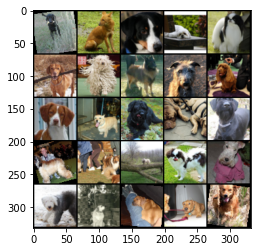

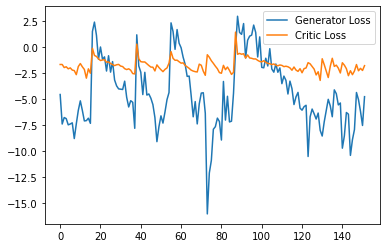

Step 3100: Generator loss: -5.197959431409836, critic loss: -2.3935979545116424


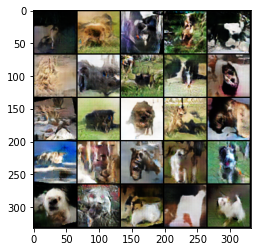

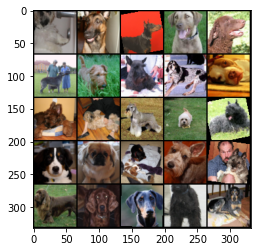

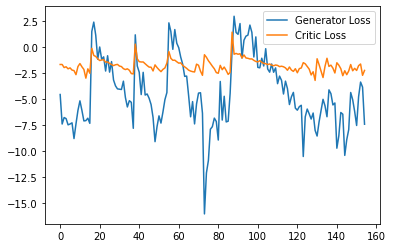

Step 3150: Generator loss: -2.617426815032959, critic loss: -1.3824219102660813


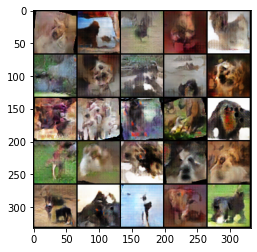

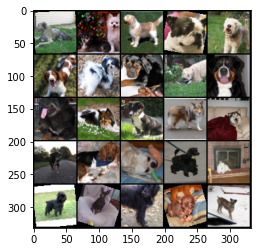

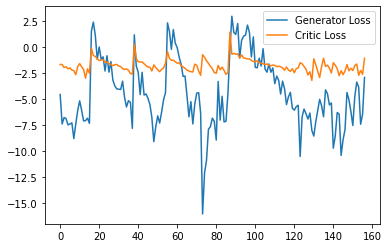

Step 3200: Generator loss: 2.2534902638196943, critic loss: -0.8756441879520814


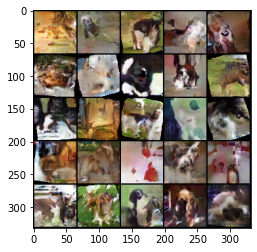

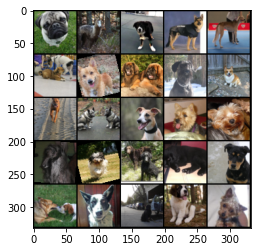

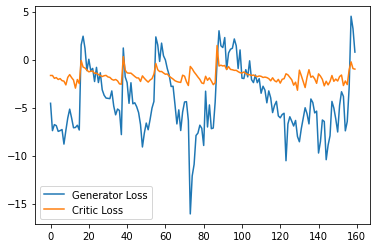

Step 3250: Generator loss: 0.4678246559947729, critic loss: -1.3240678536891934


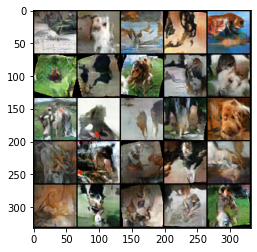

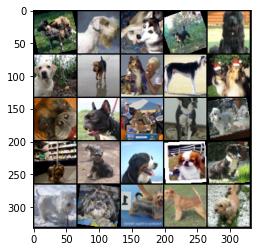

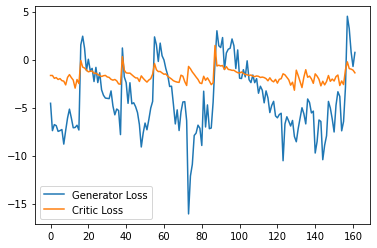

Step 3300: Generator loss: 0.4053253594040871, critic loss: -1.5577454851071042


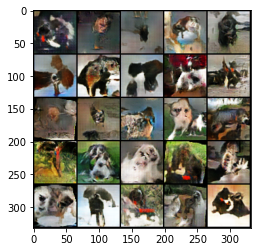

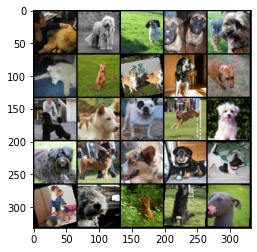

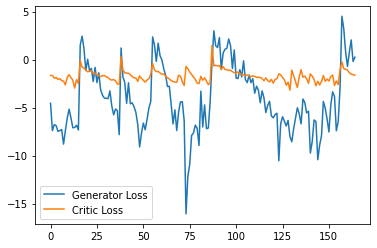

Step 3350: Generator loss: -1.0859971252083778, critic loss: -1.7448774600029


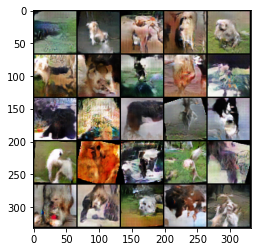

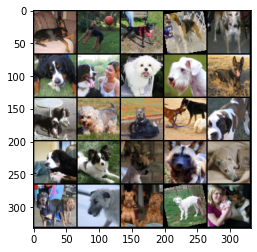

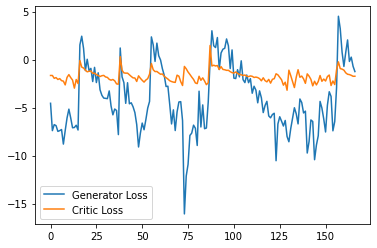

Step 3400: Generator loss: -1.3766145029664039, critic loss: -2.0112943760553996


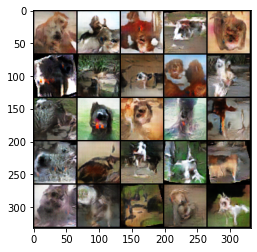

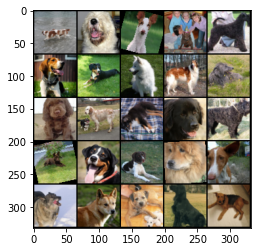

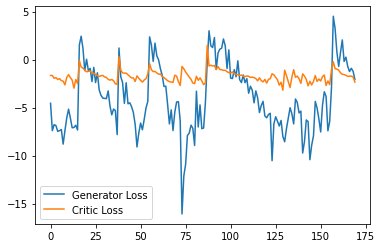

Step 3450: Generator loss: -3.1485797257721426, critic loss: -2.1312491738796235


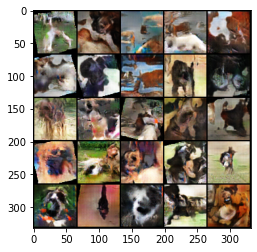

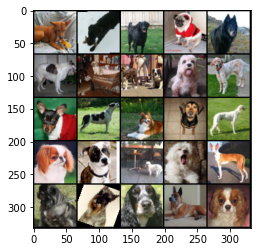

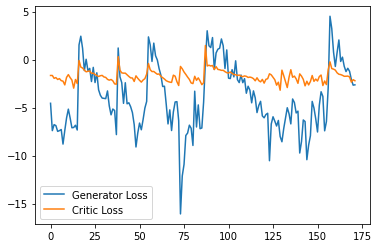

Step 3500: Generator loss: -3.3266246321797373, critic loss: -2.135432132383187


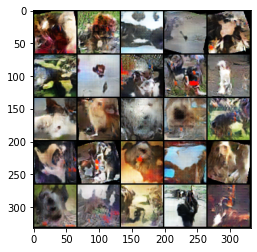

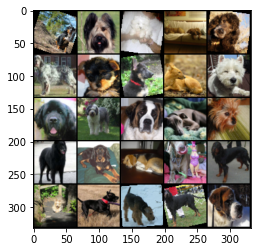

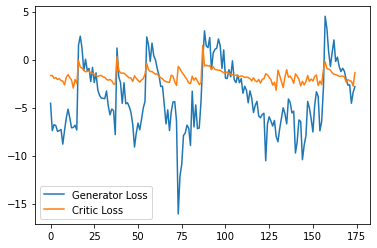

Step 3550: Generator loss: -2.6715719759464265, critic loss: -2.2588699833552046


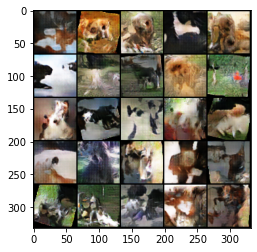

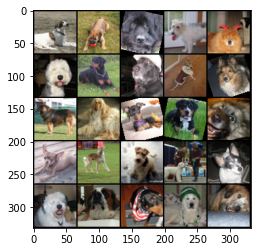

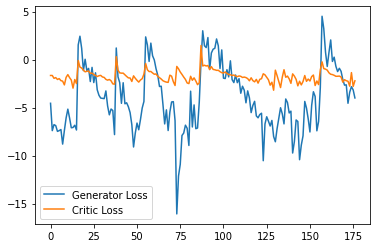

Step 3600: Generator loss: -3.416358767449856, critic loss: -2.1136921649177878


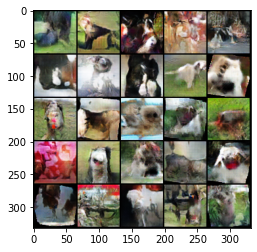

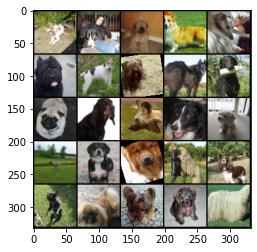

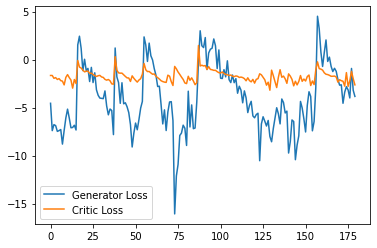

Step 3650: Generator loss: -4.12325502038002, critic loss: -2.328887341717879


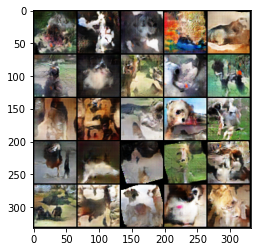

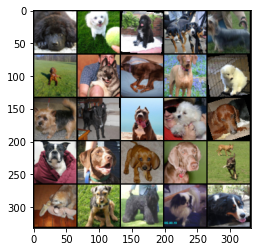

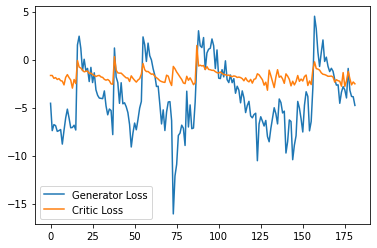

Step 3700: Generator loss: -4.66281267285347, critic loss: -2.237227273285389


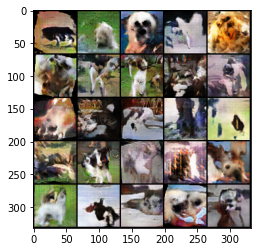

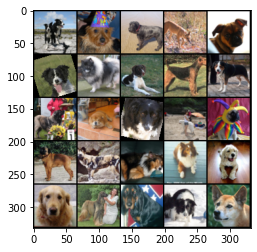

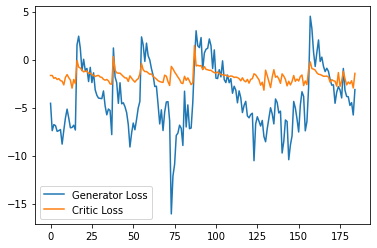

Step 3750: Generator loss: -3.176855516731739, critic loss: -1.4717575635015958


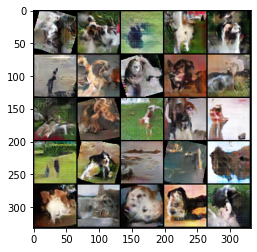

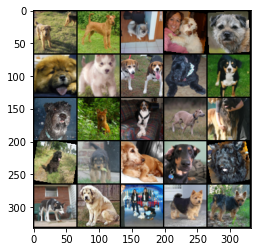

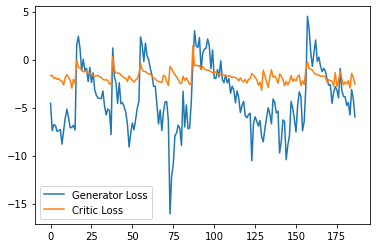

Step 3800: Generator loss: 5.5547966957092285, critic loss: -0.380077789016068


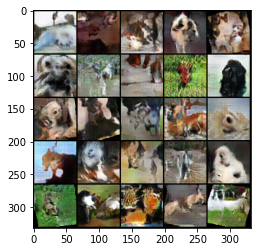

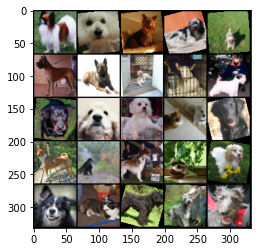

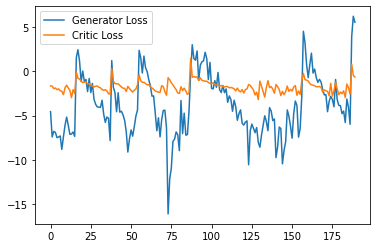

Step 3850: Generator loss: 2.2228494679927824, critic loss: -0.6942987495288253


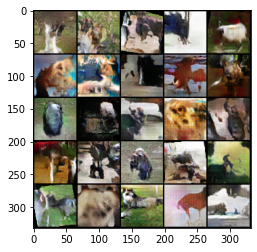

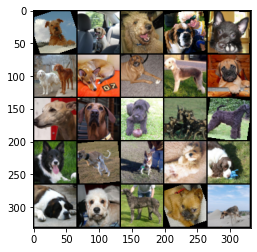

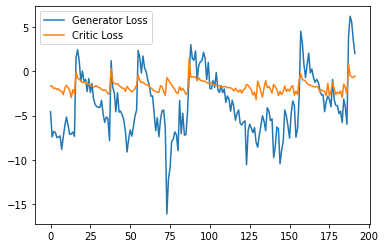

Step 3900: Generator loss: 1.1053708899021149, critic loss: -0.8063336735467117


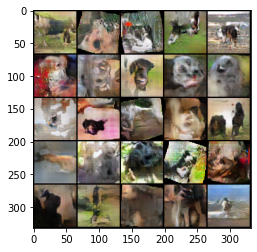

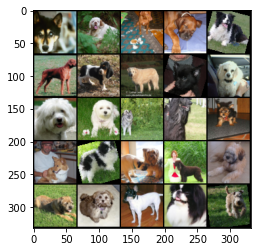

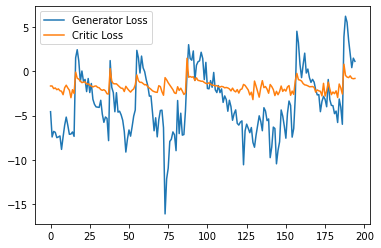

Step 3950: Generator loss: -0.45553556323051453, critic loss: -0.961396656533082


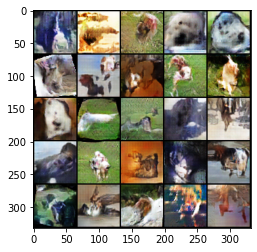

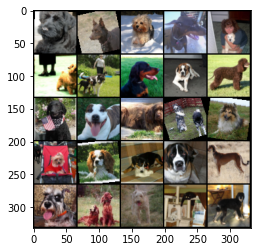

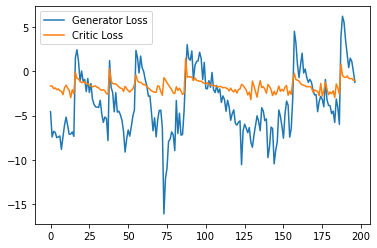

Step 4000: Generator loss: -0.5762789806723595, critic loss: -1.1931657340129216


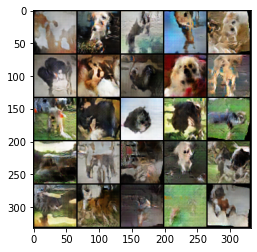

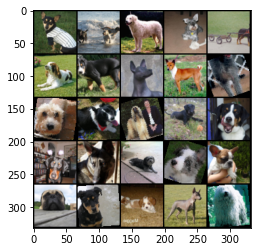

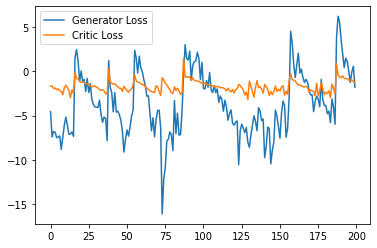

Step 4050: Generator loss: -0.9393322685360909, critic loss: -1.3470456269383428


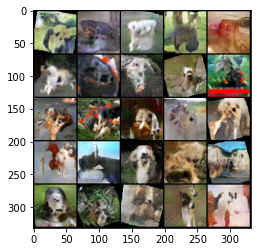

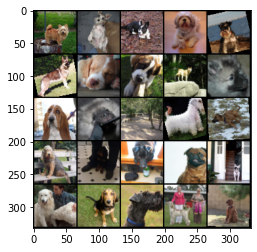

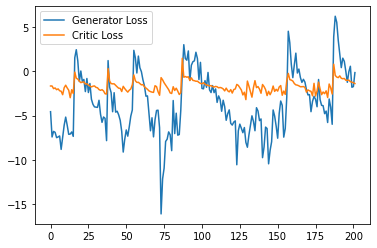

Step 4100: Generator loss: -1.7648879897594452, critic loss: -1.5423734794060389


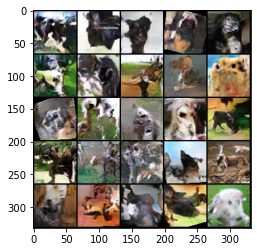

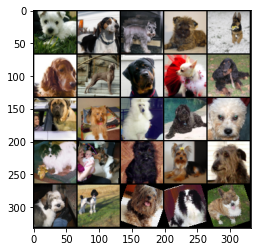

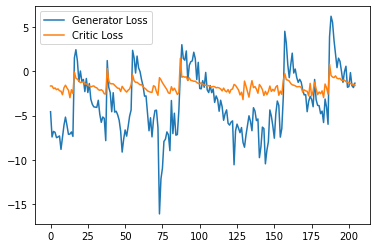

Step 4150: Generator loss: -2.097959611415863, critic loss: -1.5408991636832556


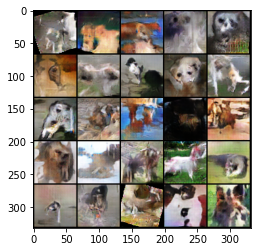

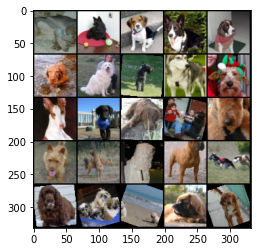

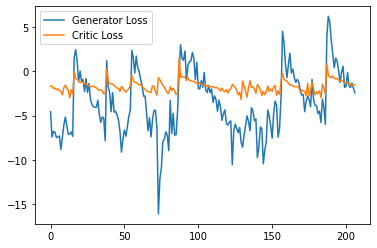

Step 4200: Generator loss: -2.3637785950303076, critic loss: -1.739155959288279


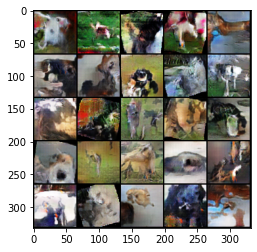

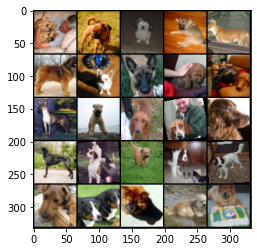

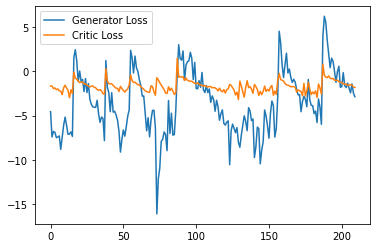

Step 4250: Generator loss: -2.9350411343574523, critic loss: -1.8296837457021078


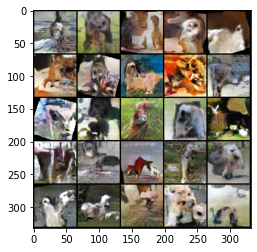

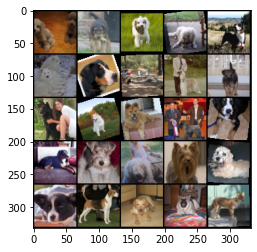

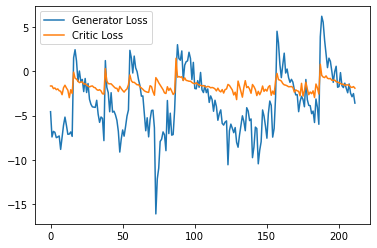

Step 4300: Generator loss: -4.148029502630234, critic loss: -2.2359994614124297


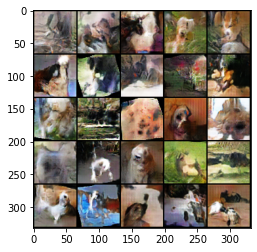

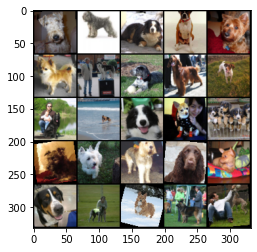

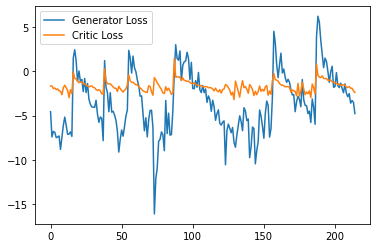

Step 4350: Generator loss: -5.114717676639557, critic loss: -2.551764466961225


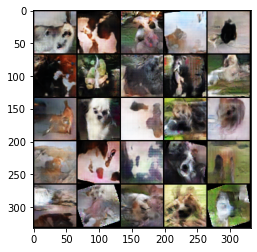

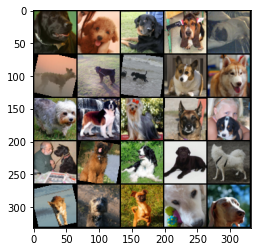

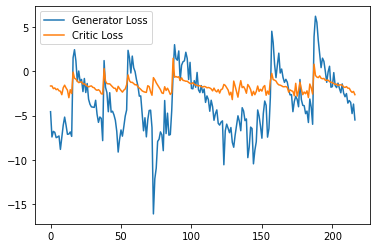

Step 4400: Generator loss: 0.3914423274993897, critic loss: -0.7465549007058142


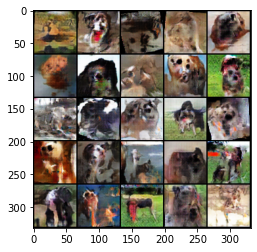

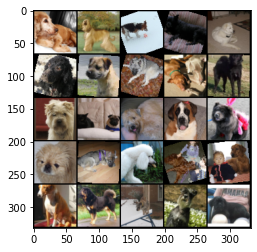

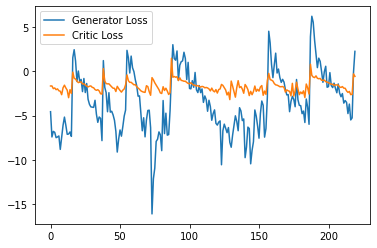

Step 4450: Generator loss: 1.7269175404310226, critic loss: -1.1964979102710884


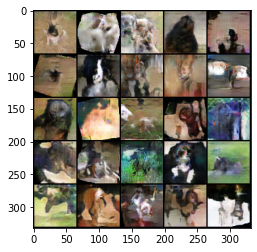

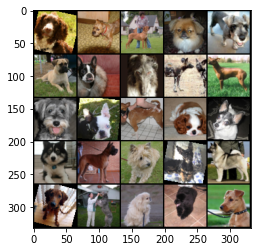

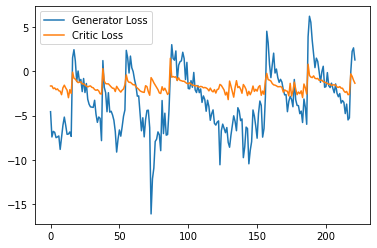

Step 4500: Generator loss: 1.2921728610992431, critic loss: -1.396067971984545


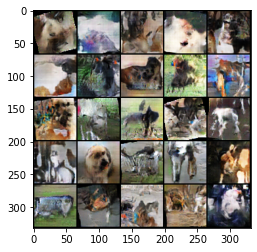

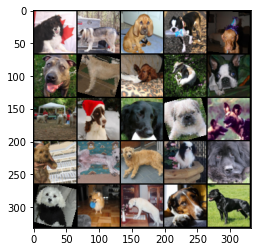

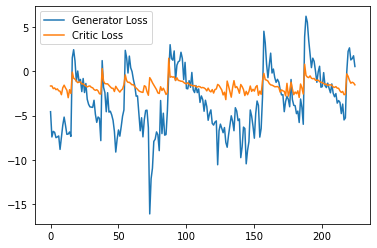

KeyboardInterrupt: 

In [20]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            #print(real.shape)
            #print(fake.shape)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()
            torch.save({
                'epoch': epoch,
                'gen_state_dict': gen.state_dict(),
                'gen_optimizer_state_dict': gen_opt.state_dict(),
                'crit_state_dict': crit.state_dict(),
                'crit_optimizer_state_dict': crit_opt.state_dict(),
                'gen_loss': gen_loss.item(),
                'crit_loss': crit_loss.item(),
                }, CHK_PT)

        cur_step += 1

In [30]:
import os
from torchvision.utils import save_image
if not os.path.exists('../output-images-wgan-v1-1/'):
    os.mkdir('../output-images-wgan-v1-1/')
    
im_batch_size = 50
n_images=2000

for i_batch in tqdm(range(0, n_images, im_batch_size)):
    gen_z = torch.randn(im_batch_size, z_dim, 1, 1, device=device)
    #with truncation trick
    gen_z = torch.clamp(gen_z, min=-0.5, max=0.5)
    gen_z = torch.randn(im_batch_size, z_dim, 1, 1, device=device)
    gen_images = gen(gen_z)
    images = gen_images.to("cpu").clone().detach()
    images = images.numpy().transpose(0, 2, 3, 1)
    images
    for i_image in range(gen_images.size(0)):
        save_image((gen_images[i_image, :, :, :]+1.)/2., os.path.join('../output-images-wgan-v1-1/', f'image_{i_batch+i_image:05d}.png'))

In [31]:
from fid_score.fid_score import FidScore

paths =  ["../ground-truth-sample/","../output-images-wgan-v1-1/"]

fid = FidScore(paths, device, batch_size)

score = fid.calculate_fid_score()
print("FID=",score)

  0%|                                                                                           | 0/32 [00:00<?, ?it/s]

Present batch 1/64

  3%|██▌                                                                                | 1/32 [00:00<00:15,  1.96it/s]

done
Present batch 65/64

  6%|█████▏                                                                             | 2/32 [00:00<00:14,  2.02it/s]

done
Present batch 129/64

  9%|███████▊                                                                           | 3/32 [00:01<00:14,  2.06it/s]

done
Present batch 193/64

 12%|██████████▍                                                                        | 4/32 [00:01<00:13,  2.07it/s]

done
Present batch 257/64

 16%|████████████▉                                                                      | 5/32 [00:02<00:12,  2.09it/s]

done
Present batch 321/64

 19%|███████████████▌                                                                   | 6/32 [00:02<00:12,  2.12it/s]

done
Present batch 385/64

 22%|██████████████████▏                                                                | 7/32 [00:03<00:11,  2.13it/s]

done
Present batch 449/64

 25%|████████████████████▊                                                              | 8/32 [00:03<00:11,  2.13it/s]

done
Present batch 513/64

 28%|███████████████████████▎                                                           | 9/32 [00:04<00:10,  2.14it/s]

done
Present batch 577/64

 31%|█████████████████████████▋                                                        | 10/32 [00:04<00:10,  2.15it/s]

done
Present batch 641/64

 34%|████████████████████████████▏                                                     | 11/32 [00:05<00:09,  2.16it/s]

done
Present batch 705/64

 38%|██████████████████████████████▊                                                   | 12/32 [00:05<00:09,  2.14it/s]

done
Present batch 769/64

 41%|█████████████████████████████████▎                                                | 13/32 [00:06<00:08,  2.13it/s]

done
Present batch 833/64

 44%|███████████████████████████████████▉                                              | 14/32 [00:06<00:08,  2.14it/s]

done
Present batch 897/64

 47%|██████████████████████████████████████▍                                           | 15/32 [00:07<00:07,  2.14it/s]

done
Present batch 961/64

 50%|█████████████████████████████████████████                                         | 16/32 [00:07<00:07,  2.14it/s]

done
Present batch 1025/64

 53%|███████████████████████████████████████████▌                                      | 17/32 [00:07<00:07,  2.12it/s]

done
Present batch 1089/64

 56%|██████████████████████████████████████████████▏                                   | 18/32 [00:08<00:06,  2.13it/s]

done
Present batch 1153/64

 59%|████████████████████████████████████████████████▋                                 | 19/32 [00:08<00:06,  2.15it/s]

done
Present batch 1217/64

 62%|███████████████████████████████████████████████████▎                              | 20/32 [00:09<00:05,  2.15it/s]

done
Present batch 1281/64

 66%|█████████████████████████████████████████████████████▊                            | 21/32 [00:09<00:05,  2.15it/s]

done
Present batch 1345/64

 69%|████████████████████████████████████████████████████████▍                         | 22/32 [00:10<00:04,  2.13it/s]

done
Present batch 1409/64

 72%|██████████████████████████████████████████████████████████▉                       | 23/32 [00:10<00:04,  2.13it/s]

done
Present batch 1473/64

 75%|█████████████████████████████████████████████████████████████▌                    | 24/32 [00:11<00:03,  2.13it/s]

done
Present batch 1537/64

 78%|████████████████████████████████████████████████████████████████                  | 25/32 [00:11<00:03,  2.14it/s]

done
Present batch 1601/64

 81%|██████████████████████████████████████████████████████████████████▋               | 26/32 [00:12<00:02,  2.14it/s]

done
Present batch 1665/64

 84%|█████████████████████████████████████████████████████████████████████▏            | 27/32 [00:12<00:02,  2.13it/s]

done
Present batch 1729/64

 88%|███████████████████████████████████████████████████████████████████████▊          | 28/32 [00:13<00:01,  2.13it/s]

done
Present batch 1793/64

 91%|██████████████████████████████████████████████████████████████████████████▎       | 29/32 [00:13<00:01,  2.15it/s]

done
Present batch 1857/64

 94%|████████████████████████████████████████████████████████████████████████████▉     | 30/32 [00:14<00:00,  2.15it/s]

done
Present batch 1921/64

 97%|███████████████████████████████████████████████████████████████████████████████▍  | 31/32 [00:14<00:00,  2.15it/s]

done
Present batch 1985/64

100%|██████████████████████████████████████████████████████████████████████████████████| 32/32 [00:14<00:00,  2.19it/s]

done



  0%|                                                                                           | 0/32 [00:00<?, ?it/s]

Present batch 1/64

  3%|██▌                                                                                | 1/32 [00:00<00:24,  1.27it/s]

done
Present batch 65/64

  6%|█████▏                                                                             | 2/32 [00:01<00:24,  1.23it/s]

done
Present batch 129/64

  9%|███████▊                                                                           | 3/32 [00:02<00:23,  1.22it/s]

done
Present batch 193/64

 12%|██████████▍                                                                        | 4/32 [00:03<00:22,  1.25it/s]

done
Present batch 257/64

 16%|████████████▉                                                                      | 5/32 [00:04<00:21,  1.25it/s]

done
Present batch 321/64

 19%|███████████████▌                                                                   | 6/32 [00:04<00:20,  1.26it/s]

done
Present batch 385/64

 22%|██████████████████▏                                                                | 7/32 [00:05<00:20,  1.24it/s]

done
Present batch 449/64

 25%|████████████████████▊                                                              | 8/32 [00:06<00:19,  1.22it/s]

done
Present batch 513/64

 28%|███████████████████████▎                                                           | 9/32 [00:07<00:18,  1.24it/s]

done
Present batch 577/64

 31%|█████████████████████████▋                                                        | 10/32 [00:08<00:17,  1.24it/s]

done
Present batch 641/64

 34%|████████████████████████████▏                                                     | 11/32 [00:08<00:16,  1.25it/s]

done
Present batch 705/64

 38%|██████████████████████████████▊                                                   | 12/32 [00:09<00:16,  1.25it/s]

done
Present batch 769/64

 41%|█████████████████████████████████▎                                                | 13/32 [00:10<00:15,  1.25it/s]

done
Present batch 833/64

 44%|███████████████████████████████████▉                                              | 14/32 [00:11<00:14,  1.24it/s]

done
Present batch 897/64

 47%|██████████████████████████████████████▍                                           | 15/32 [00:12<00:14,  1.21it/s]

done
Present batch 961/64

 50%|█████████████████████████████████████████                                         | 16/32 [00:13<00:13,  1.20it/s]

done
Present batch 1025/64

 53%|███████████████████████████████████████████▌                                      | 17/32 [00:13<00:12,  1.19it/s]

done
Present batch 1089/64

 56%|██████████████████████████████████████████████▏                                   | 18/32 [00:14<00:11,  1.19it/s]

done
Present batch 1153/64

 59%|████████████████████████████████████████████████▋                                 | 19/32 [00:15<00:10,  1.21it/s]

done
Present batch 1217/64

 62%|███████████████████████████████████████████████████▎                              | 20/32 [00:16<00:09,  1.24it/s]

done
Present batch 1281/64

 66%|█████████████████████████████████████████████████████▊                            | 21/32 [00:17<00:08,  1.23it/s]

done
Present batch 1345/64

 69%|████████████████████████████████████████████████████████▍                         | 22/32 [00:17<00:08,  1.24it/s]

done
Present batch 1409/64

 72%|██████████████████████████████████████████████████████████▉                       | 23/32 [00:18<00:07,  1.24it/s]

done
Present batch 1473/64

 75%|█████████████████████████████████████████████████████████████▌                    | 24/32 [00:19<00:06,  1.25it/s]

done
Present batch 1537/64

 78%|████████████████████████████████████████████████████████████████                  | 25/32 [00:20<00:05,  1.25it/s]

done
Present batch 1601/64

 81%|██████████████████████████████████████████████████████████████████▋               | 26/32 [00:21<00:04,  1.25it/s]

done
Present batch 1665/64

 84%|█████████████████████████████████████████████████████████████████████▏            | 27/32 [00:21<00:03,  1.26it/s]

done
Present batch 1729/64

 88%|███████████████████████████████████████████████████████████████████████▊          | 28/32 [00:22<00:03,  1.26it/s]

done
Present batch 1793/64

 91%|██████████████████████████████████████████████████████████████████████████▎       | 29/32 [00:23<00:02,  1.24it/s]

done
Present batch 1857/64

 94%|████████████████████████████████████████████████████████████████████████████▉     | 30/32 [00:24<00:01,  1.24it/s]

done
Present batch 1921/64

 97%|███████████████████████████████████████████████████████████████████████████████▍  | 31/32 [00:25<00:00,  1.23it/s]

done
Present batch 1985/64

100%|██████████████████████████████████████████████████████████████████████████████████| 32/32 [00:25<00:00,  1.26it/s]

done


FID= 157.2312660446894


In [25]:
import os, random
import shutil

src_dir = "../data/processed-data/cropped-dogs/"
dst_dir = "../ground-truth-sample/"
if not os.path.exists(dst_dir):
    os.mkdir(dst_dir)


file_list = os.listdir(src_dir)
to_copy = random.sample(file_list,2000)

for i in to_copy:
        #a = random.choice(file_list)
        #file_list.remove(a)
        shutil.copy(src_dir + i, dst_dir + i)